In [ ]:
pip install opencv-python


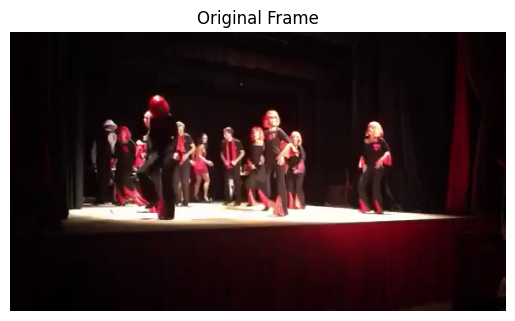

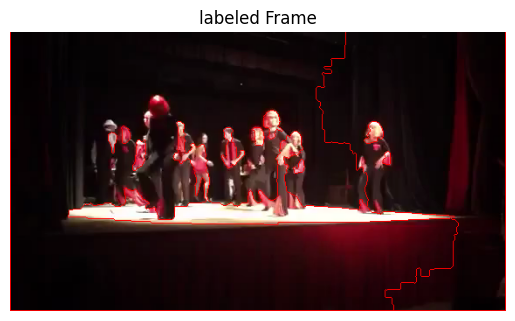

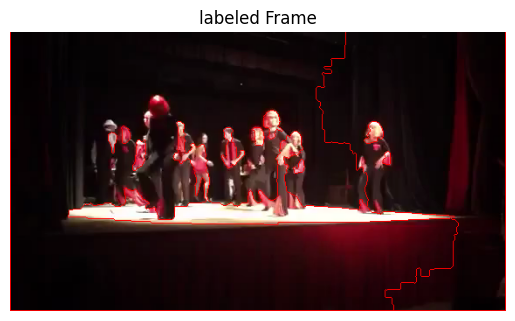

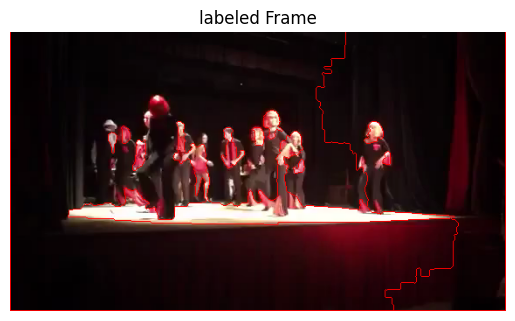

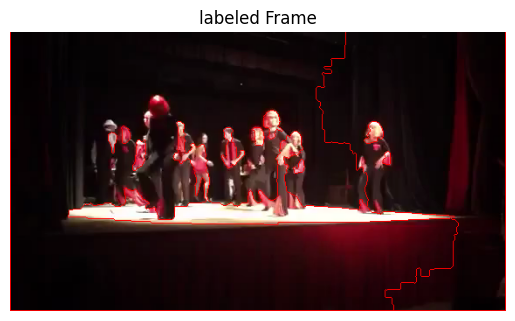

...

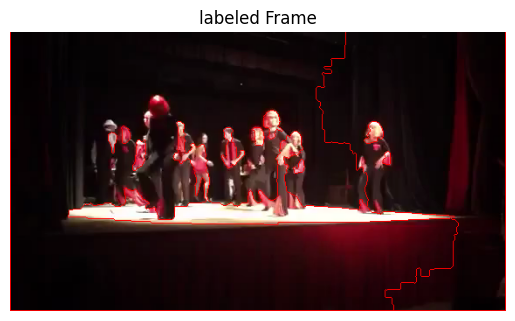

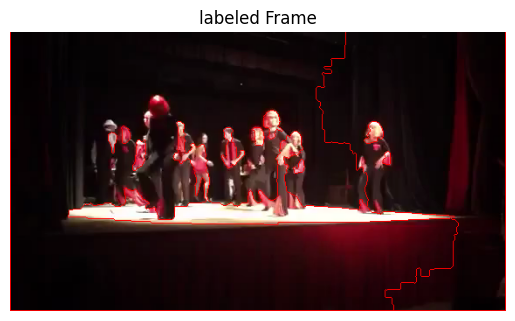

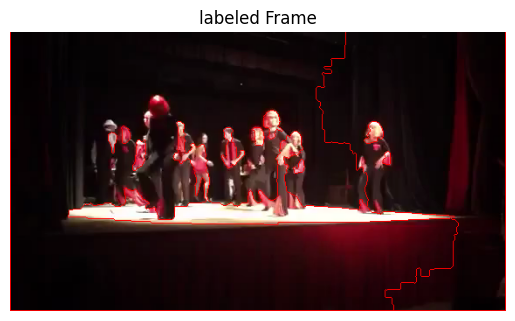

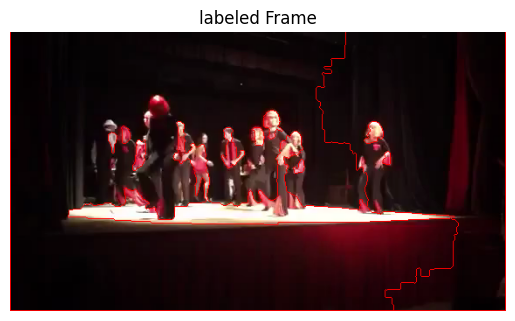

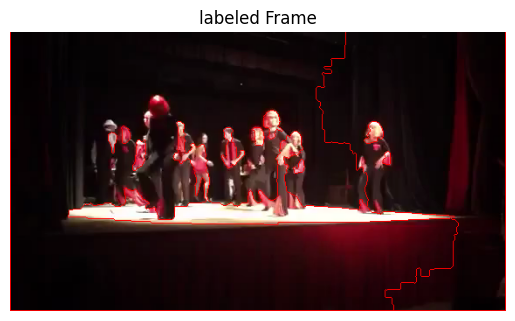

In [5]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Step 1: Read the Video Data
video_path = "/Users/sudachk/PacktPublishing/DataLabelling/ch09/Kinetics/dance/dancing2.mp4"
cap = cv2.VideoCapture(video_path)

# Step 2: Extract Frames from the Video
frames = []
while True:
    ret, frame = cap.read()
    if not ret:
        break
    frames.append(frame)
cap.release()

# Display the first original frame 

plt.imshow(cv2.cvtColor(frames[0], cv2.COLOR_BGR2RGB)) 

plt.title('Original Frame') 

plt.axis('off') 

plt.show() 

# Step 3: Apply Watershed Algorithm to Each Frame
labeled_frames = []
for frame in frames:
    # Convert the frame to grayscale
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Apply thresholding to obtain a binary image
    _, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)

    # Perform morphological operations to remove noise and fill holes
    kernel = np.ones((3, 3), np.uint8)
    opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=2)
    sure_bg = cv2.dilate(opening, kernel, iterations=3)

    # Apply the distance transform to identify markers
    dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
    _, sure_fg = cv2.threshold(dist_transform, 0.7*dist_transform.max(), 255, 0)

    # Combine the background and foreground markers
    sure_fg = np.uint8(sure_fg)
    unknown = cv2.subtract(sure_bg, sure_fg)

    # Apply the watershed algorithm to label the regions
    _, markers = cv2.connectedComponents(sure_fg)
    markers = markers + 1
    markers[unknown == 255] = 0
    markers = cv2.watershed(frame, markers)

    # Colorize the regions for visualization
    frame[markers == -1] = [0, 0, 255]

    labeled_frames.append(frame)

# Display the labeled frames
#for labeled_frame in labeled_frames:
    cv2.imwrite('/Users/sudachk/PacktPublishing/DataLabelling/ch09/Kinetics/watershed/segmentation.jpg', labeled_frames[0]) 
    plt.imshow(cv2.cvtColor(labeled_frames[0], cv2.COLOR_BGR2RGB))
    plt.title('labeled Frame')     
    plt.axis('off')
    plt.show()
